In [ ]:
import numpy as np
import pandas as pd
import plotly.express as px
from statsmodels.tsa.ar_model import AR
from statsmodels.tsa.arima_model import ARMA, ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [ ]:
df = pd.read_csv('/content/LA_weather.csv')
df.head()

,Date,Observed,Humidity
0,2012-10-01 13:00:00,291.870000,88.0
1,2012-10-01 14:00:00,291.868186,88.0
2,2012-10-01 15:00:00,291.862844,88.0
3,2012-10-01 16:00:00,291.857503,88.0
4,2012-10-01 17:00:00,291.852162,88.0


In [ ]:
df['Date'] = pd.to_datetime(df['Date'])

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45099 entries, 0 to 45098
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Date      45099 non-null  datetime64[ns]
 1   Observed  45099 non-null  float64       
 2   Humidity  45099 non-null  float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 1.0 MB


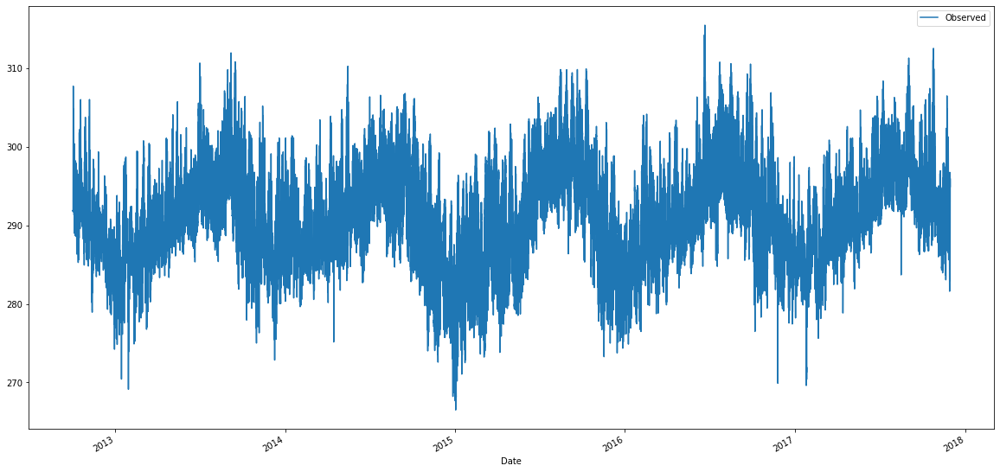

In [ ]:
df.plot(x='Date', y='Observed', figsize=(20,10))

In [ ]:
def ilinechart(df, x, y, groups=None, title=''):
    fig = px.line(df, x=x, y=y, color=groups, title=title, 
                  template='none')
    
    fig.show()

In [ ]:
ilinechart(df, 'Date', 'Observed')

In [ ]:
model = AR(df['Observed']).fit()
df['AR'] = model.predict()

In [ ]:
melted = pd.melt(df, id_vars='Date', value_vars=['Observed', 'AR'])

ilinechart(melted, 'Date', 'value', groups='variable', title='Observed vs. Modeled')

In [ ]:
model = ARMA(df['Observed'], order=(0,1)).fit()
df['MA'] = model.predict()

In [ ]:
print(model.summary())

                              ARMA Model Results                              
Dep. Variable:               Observed   No. Observations:                45099
Model:                     ARMA(0, 1)   Log Likelihood             -124159.975
Method:                       css-mle   S.D. of innovations              3.797
Date:                Thu, 11 Feb 2021   AIC                         248325.949
Time:                        15:27:46   BIC                         248352.099
Sample:                             0   HQIC                        248334.180
                                                                              
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
const            290.8458      0.033   8873.646      0.000     290.782     290.910
ma.L1.Observed     0.8334      0.002    488.891      0.000       0.830       0.837
                                    

In [ ]:
melted = pd.melt(df, id_vars='Date', value_vars=['Observed', 'AR', 'MA'])

ilinechart(melted, 'Date', 'value', groups='variable', title='Observed vs. Modeled')

In [ ]:
model = ARMA(df['Observed'], order=(5,0)).fit()
# df['ARMA'] = model.predict()
print(model.summary())
# y = c1*x1 + c2*x2 + b

                              ARMA Model Results                              
Dep. Variable:               Observed   No. Observations:                45099
Model:                     ARMA(5, 0)   Log Likelihood              -79354.299
Method:                       css-mle   S.D. of innovations              1.406
Date:                Thu, 11 Feb 2021   AIC                         158722.598
Time:                        16:10:37   BIC                         158783.615
Sample:                             0   HQIC                        158741.804
                                                                              
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
const            290.8461      0.100   2921.216      0.000     290.651     291.041
ar.L1.Observed     1.0480      0.005    222.573      0.000       1.039       1.057
ar.L2.Observed     0.2134      0.007

In [ ]:
melted = pd.melt(df, id_vars='Date', value_vars=['Observed', 'AR', 'MA', 'ARMA'])

ilinechart(melted, 'Date', 'value', groups='variable', title='Observed vs. Modeled')

In [ ]:
model = ARIMA(df['Observed'], order=([1,1,1])).fit()
df['ARIMA'] = model.predict(typ='levels')
print(model.summary())

                             ARIMA Model Results                              
Dep. Variable:             D.Observed   No. Observations:                45098
Model:                 ARIMA(1, 1, 1)   Log Likelihood              -82579.656
Method:                       css-mle   S.D. of innovations              1.510
Date:                Thu, 11 Feb 2021   AIC                         165167.312
Time:                        15:49:32   BIC                         165202.179
Sample:                             1   HQIC                        165178.287
                                                                              
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const             6.144e-05      0.014      0.004      0.997      -0.028       0.028
ar.L1.D.Observed     0.7541      0.005    151.741      0.000       0.744       0.764
ma.L1.D.Observed    -0.5042 

In [ ]:
melted = pd.melt(df, id_vars='Date', value_vars=['Observed', 'AR', 'MA', 'ARMA', 'ARIMA'])

ilinechart(melted, 'Date', 'value', groups='variable', title='Observed vs. Modeled')

In [ ]:
model = SARIMAX(df['Observed'], order=(1,1,1), seasonal_order=(1,1,1,1)).fit()
df['SARIMA'] = model.predict()
print(model.summary())

                                 Statespace Model Results                                
Dep. Variable:                          Observed   No. Observations:                45099
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 1)   Log Likelihood              -83761.284
Date:                           Thu, 11 Feb 2021   AIC                         167532.568
Time:                                   15:52:51   BIC                         167576.151
Sample:                                        0   HQIC                        167546.286
                                         - 45099                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1564      0.004    -41.446      0.000      -0.164      -0.149
ma.L1         -0.2230      0.004    -55.997

In [ ]:
melted = pd.melt(df[2:], id_vars='Date', value_vars=['Observed', 'ARIMA', 'SARIMA'])

ilinechart(melted, 'Date', 'value', groups='variable', title='Observed vs. Modeled')

In [ ]:
model = SARIMAX(df['Observed'], exog=df['Humidity'], order=(1,1,1), seasonal_order=(0,0,0,0)).fit()
df['SARIMAX'] = model.predict()
print(model.summary())

                           Statespace Model Results                           
Dep. Variable:               Observed   No. Observations:                45099
Model:               SARIMAX(1, 1, 1)   Log Likelihood              -80952.282
Date:                Thu, 11 Feb 2021   AIC                         161912.565
Time:                        15:59:08   BIC                         161947.431
Sample:                             0   HQIC                        161923.539
                              - 45099                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Humidity      -0.0713      0.000   -173.079      0.000      -0.072      -0.071
ar.L1          0.9338      0.002    529.319      0.000       0.930       0.937
ma.L1         -0.9950      0.000  -2143.743      0.0

In [ ]:
melted = pd.melt(df[2:], id_vars='Date', value_vars=['Observed', 'ARIMA', 'SARIMA', 'SARIMAX'])

ilinechart(melted, 'Date', 'value', groups='variable', title='Observed vs. Modeled')

In [ ]:
models = ['AR', 'MA', 'ARMA', 'ARIMA', 'SARIMA', 'SARIMAX']

for model in models:
  diff = df['Observed'] - df[model]
  mae = diff.abs().mean()
  rmse = np.sqrt(np.mean(diff**2))
  print(f'Model {model} - MAE: {mae} | RMSE {rmse}')

Model AR - MAE: 0.6235751759819345 | RMSE 1.0082121241910873
Model MA - MAE: 2.991823113586883 | RMSE 3.7965874889646103
Model ARMA - MAE: 1.0425011183152935 | RMSE 1.5691905970781739
Model ARIMA - MAE: 0.928065920493702 | RMSE 1.510115735550075
Model SARIMA - MAE: 1.0000925874659812 | RMSE 2.1827293447282523
Model SARIMAX - MAE: 1.0212641614163132 | RMSE 2.023011472455423
